# Chaos and Fractals: An Elementary Introduction

The following notebook contains investigations in F# based upon the book [*Chaos and Fractals: An Elementary Introduction* by David P. Feldman](http://hornacek.coa.edu/dave/Chaos/).

### Dependencies

In [1]:
#r "nuget: Plotly.NET.Interactive"
#r "nuget: Plotly.NET.ImageExport"

Installed Packages Plotly.NET.ImageExport, 5.0.1 Plotly.NET.Interactive, 4.2.1

In [2]:
#load @"..\fsharp-math\Math\Math\Complex.fs"

In [3]:
open FSharp.Math.Complex

In [4]:
open System.Runtime.CompilerServices

open Plotly.NET
open Plotly.NET.ImageExport
open Plotly.NET.LayoutObjects
open Plotly.NET.TraceObjects

### Utilities

In [5]:
type Coordinate =
    { X: float
      Y: float
      Z: float } with
    
    member this.AsTuple = (this.X, this.Y, this.Z)
    static member ToTuple {Coordinate.X = x; Y = y; Z = z} = (x, y, z)

let coordinate (x, y, z) = {X = x; Y = y; Z = z}

type Plot =
    { Time: float 
      Coordinate: Coordinate }

In [6]:
let axis3D = LinearAxis.init(
    ShowLine = false,
    ShowGrid = false,
    ShowBackground = false,
    Color = Color.fromKeyword(White),
    Ticks = StyleParam.TickOptions.Empty,
    Visible = false
)

let scene3D = Scene.init(
    BGColor = Color.fromKeyword(White),
    XAxis = axis3D,
    YAxis = axis3D,
    ZAxis = axis3D
)

let layout3D = Layout.init(
    PlotBGColor = Color.fromKeyword(White),
    PaperBGColor = Color.fromKeyword(White)
)

let margin3D = Margin.init(
    Left = 0,
    Right = 0,
    Top = 0,
    Bottom = 0,
    Pad = 0,
    Autoexpand = true
)

let plot plot =
    plot
    |> List.map (fun plot -> plot.Coordinate.AsTuple)
    |> (fun x -> Chart.Line3D(x,
        LineColor = Color.fromARGB 65 0 0 0))
    |> Chart.withLayout layout3D
    |> Chart.withScene scene3D
    |> Chart.withMargin margin3D
    |> Chart.withXAxis axis3D
    |> Chart.withYAxis axis3D
    |> Chart.withZAxis axis3D

In [7]:
let staticConfig = Config.init(
    StaticPlot = true
)

type Chart with
    static member Display (chart: GenericChart.GenericChart) =
        match GenericChart.tryGetLayoutSize chart with
        | Some width, Some height ->
            chart
            |> Chart.withConfig staticConfig
            |> Chart.toSVGString(Width = width, Height = height)
            |> (fun chart -> chart.DisplayAs "text/html")
        | _ ->
            chart
            |> Chart.withConfig staticConfig
            |> Chart.toSVGString()
            |> (fun chart -> chart.DisplayAs "text/html")

    static member Display3D (x, y, z, chart: GenericChart.GenericChart) =
        let axis3D = LinearAxis.init(
            ShowLine = false,
            ShowGrid = false,
            ShowBackground = false,
            Color = Color.fromKeyword(White),
            Ticks = StyleParam.TickOptions.Empty,
            Visible = false
        )

        match GenericChart.tryGetLayoutSize chart with
        | Some width, Some height ->
            chart
            |> Chart.withConfig staticConfig
            |> Chart.withSceneStyle(
                Camera = Camera.init(
                    Center = CameraCenter.init(0, 0, 0),
                    Eye = CameraEye.init(x, y, z),
                    Up = CameraUp.init(0, 0, 1)
                )
            )
            |> Chart.toSVGString(Width = width, Height = height)
            |> (fun chart -> chart.DisplayAs "text/html")
        | _ ->
            chart
            |> Chart.withConfig staticConfig
            |> Chart.withSceneStyle(
                Camera = Camera.init(Center = CameraCenter.init(x, y, z))
            )
            |> Chart.toSVGString()
            |> (fun chart -> chart.DisplayAs "text/html")

### Chapter 24: Julia Sets for the Quadratic Family

In [8]:
let f (c: Complex) (z: Complex) = (z * z) + c

let test = f (complex 1 0)

let functionIteration (f: Complex -> Complex) (z0: Complex): seq<Complex> =
    f z0
    |> Seq.unfold (fun state ->
        let newState = f state
        Some (state, newState))

let goesToInfinity f (c: Complex) (z0: Complex) =
    let R = max 2.0 (abs c).Real

    let iterates =
        Seq.zip (functionIteration (f c) z0) (Seq.initInfinite id)
        |> Seq.takeWhile (fun (z, i) -> (abs z).Real < R && i <= 100)
    Seq.length iterates < 100

In [9]:
let plotJuliaSet data =
    data
    |> Chart.Point
    |> Chart.withMarkerStyle(Size = 1)
    |> Chart.withConfig staticConfig
    |> Chart.toSVGString()
    |> (fun chart -> chart.DisplayAs "text/html")

In [10]:
goesToInfinity f (complex 1 0) (complex 0 0)

True

In [11]:
goesToInfinity f (complex 1 0) (complex 0 1)

True

In [12]:
goesToInfinity f (complex 1 0) (complex 1 1)

True

In [13]:
goesToInfinity f (complex 1 0) (complex 0.8 0.2)

True

In [14]:
functionIteration (f (complex 1 0)) (complex 0 0) |> Seq.take 5

[ 1, 2, 5, 26, 677 ] CheckClose False LastGenerated 0 Real 0 Imaginary 0 count 5 source [ 1, 2, 5, 26, 677, 458330, 210066388901, 4.4127887745906175E+22, 1.9472704769152963E+45, 3.7918623102659254E+90, 1.437821978001524E+181, ∞, ∞ - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi ... (more) ] f Microsoft.FSharp.Collections.SeqModule+mkUnfoldSeq@599[FSI_0007.FSharp.Math.Complex+Complex,FSI_0007.FSharp.Math.Complex+Complex] f FSI_0013+functionIteration@7 f FSI_0019+it@1-4 c 1 Real 1 Imaginary 0 x 1 Real 1 Imaginary 0 (values) index value 0 1 Real 1 Imaginary 0 1 2 Real 2 Imaginary 0 2 5 Real 5 Imaginary 0 3 26 Real 26 Imaginary 0 4 677 Real 677 Imaginary 0 5 458330 Real 458330 Imaginary 0 6 210066388901 Real 210066388901 Imaginary 0 7 4.4127887745906175E+22 Real 4.4127887745906175E+22 Imaginary 0 8 1.9472704769152963E+45 Real 1.9472704769152963E+45 Imaginary 0 9 3.7918623102659254E+90 Real 3.7918623102659254E+90 Imaginary 0 10 1.437821978001524E+181 Real 1.437821978001524E+181 Imaginary 0 11 ∞ Real Infinity Imaginary 0 12 ∞ - NaNi Real Infinity Imaginary NaN 13 NaN - NaNi Real NaN Imaginary NaN 14 NaN - NaNi Real NaN Imaginary NaN 15 NaN - NaNi Real NaN Imaginary NaN 16 NaN - NaNi Real NaN Imaginary NaN 17 NaN - NaNi Real NaN Imaginary NaN 18 NaN - NaNi Real NaN Imaginary NaN 19 NaN - NaNi Real NaN Imaginary NaN ... (more) e <null> enum <null> pc 0 current 0 Real 0 Imaginary 0 (values) index value 0 1 Real 1 Imaginary 0 1 2 Real 2 Imaginary 0 2 5 Real 5 Imaginary 0 3 26 Real 26 Imaginary 0 4 677 Real 677 Imaginary 0

In [15]:
functionIteration (f (complex 1 0)) (complex 0 1) |> Seq.take 5

[ 0, 1, 2, 5, 26 ] CheckClose False LastGenerated 0 Real 0 Imaginary 0 count 5 source [ 0, 1, 2, 5, 26, 677, 458330, 210066388901, 4.4127887745906175E+22, 1.9472704769152963E+45, 3.7918623102659254E+90, 1.437821978001524E+181, ∞, ∞ - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi, NaN - NaNi ... (more) ] f Microsoft.FSharp.Collections.SeqModule+mkUnfoldSeq@599[FSI_0007.FSharp.Math.Complex+Complex,FSI_0007.FSharp.Math.Complex+Complex] f FSI_0013+functionIteration@7 f FSI_0020+it@1-5 c 1 Real 1 Imaginary 0 x 0 Real 0 Imaginary 0 (values) index value 0 0 Real 0 Imaginary 0 1 1 Real 1 Imaginary 0 2 2 Real 2 Imaginary 0 3 5 Real 5 Imaginary 0 4 26 Real 26 Imaginary 0 5 677 Real 677 Imaginary 0 6 458330 Real 458330 Imaginary 0 7 210066388901 Real 210066388901 Imaginary 0 8 4.4127887745906175E+22 Real 4.4127887745906175E+22 Imaginary 0 9 1.9472704769152963E+45 Real 1.9472704769152963E+45 Imaginary 0 10 3.7918623102659254E+90 Real 3.7918623102659254E+90 Imaginary 0 11 1.437821978001524E+181 Real 1.437821978001524E+181 Imaginary 0 12 ∞ Real Infinity Imaginary 0 13 ∞ - NaNi Real Infinity Imaginary NaN 14 NaN - NaNi Real NaN Imaginary NaN 15 NaN - NaNi Real NaN Imaginary NaN 16 NaN - NaNi Real NaN Imaginary NaN 17 NaN - NaNi Real NaN Imaginary NaN 18 NaN - NaNi Real NaN Imaginary NaN 19 NaN - NaNi Real NaN Imaginary NaN ... (more) e <null> enum <null> pc 0 current 0 Real 0 Imaginary 0 (values) index value 0 0 Real 0 Imaginary 0 1 1 Real 1 Imaginary 0 2 2 Real 2 Imaginary 0 3 5 Real 5 Imaginary 0 4 26 Real 26 Imaginary 0

In [16]:
1 |> Seq.unfold (fun state -> Some (state, state * 2)) |> Seq.take 5

[ 1, 2, 4, 8, 16 ] CheckClose False LastGenerated 0 count 5 source [ 1, 2, 4, 8, 16, 32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288 ... (more) ] f Microsoft.FSharp.Collections.SeqModule+mkUnfoldSeq@599[System.Int32,System.Int32] f FSI_0021+it@1-6 x 1 (values) [ 1, 2, 4, 8, 16, 32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288 ... (more) ] e <null> enum <null> pc 0 current 0 (values) [ 1, 2, 4, 8, 16 ]

In [17]:
1 |> Seq.unfold (fun state -> Some (state, state * 2)) |> Seq.take 2

[ 1, 2 ] CheckClose False LastGenerated 0 count 2 source [ 1, 2, 4, 8, 16, 32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288 ... (more) ] f Microsoft.FSharp.Collections.SeqModule+mkUnfoldSeq@599[System.Int32,System.Int32] f FSI_0022+it@1-7 x 1 (values) [ 1, 2, 4, 8, 16, 32, 64, 128, 256, 512, 1024, 2048, 4096, 8192, 16384, 32768, 65536, 131072, 262144, 524288 ... (more) ] e <null> enum <null> pc 0 current 0 (values) [ 1, 2 ]

In [18]:
// let initialConditions =
//     [| for x in -2.0 .. 0.01 .. 2.0 do
//         for y in -1.5 .. 0.01 .. 1.5 ->
//             (x, y) |]
//     |> Array.Parallel.map (fun (x, y) -> complex x y)

// let juliaSet c =
//     Array.zip (Array.Parallel.map (goesToInfinity f c) initialConditions) initialConditions
//     |> Array.filter (fun (goesToInfinity, _) -> not goesToInfinity)
//     |> Array.Parallel.map (fun (_, {Real = a; Imaginary = b}) -> (a, b))

In [24]:
let initialConditions =
    seq { for x in -2.0 .. 0.001 .. 2.0 do
            for y in -1.5 .. 0.001 .. 1.5 ->
                complex x y }

let juliaSet c =
    Seq.zip (Seq.map (goesToInfinity f c) initialConditions) initialConditions
    |> Seq.filter (fun (goesToInfinity, _) -> not goesToInfinity)
    |> Seq.map (fun (_, {Real = a; Imaginary = b}) -> (a, b))

In [27]:
// let initialConditions =
//     [| for x in -2.0 .. 0.001 .. 2.0 do
//             for y in -2.0 .. 0.001 .. 2.0 ->
//                 complex x y |]

In [21]:
#r "nuget: SkiaSharp"
open SkiaSharp

Installed Packages SkiaSharp, 2.88.6

Loading extensions from `C:\Users\bmitc\.nuget\packages\skiasharp\2.88.6\interactive-extensions\dotnet\SkiaSharp.DotNet.Interactive.dll`

In [25]:
let plotSkia width c initialConditions =
    let data =
        initialConditions
        |> Seq.filter (fun coordinate -> coordinate |> goesToInfinity f c |> not)
        |> Seq.map (fun {Real = x; Imaginary = y} -> (x, y))

    let maxX = Seq.maxBy fst data |> fst
    let minX = Seq.minBy fst data |> fst

    let maxY = Seq.maxBy snd data |> snd
    let minY = Seq.minBy snd data |> snd

    let aspectRatio = (abs (maxX - minX)) / (abs (maxY - minY))
    let height = (float width / aspectRatio) |> int

    let scalePositiveX x = (x / maxX) * (float width / 2.0)
    let scaleNegativeX x = (x / (abs minX)) * (float width / 2.0)
    let scalePositiveY y = (y / maxY) * (float height / 2.0)
    let scaleNegativeY y = (y / (abs minY)) * (float height / 2.0)

    let scaleX x =
        if x >= 0.0 then
            scalePositiveX x
        else
            scaleNegativeX x

    let scaleY y =
        if y >= 0.0 then
            scalePositiveY y
        else
            scaleNegativeY y

    let scaledData = Seq.map (fun (x, y) -> (scaleX x, scaleY y)) data

    let bitmap = new SKBitmap(width, height)
    let canvas = new SKCanvas(bitmap)
    let paint = new SKPaint(Color = SKColors.Black.WithAlpha(255uy))
    canvas.Clear(SKColors.WhiteSmoke)
    canvas.Translate(float32 width / 2.0f, float32 height / 2.0f)
    canvas.RotateDegrees(180.0f)
    canvas.Scale(-1.0f, 1.0f)


    for (x, y) in scaledData do
        let point = SKPoint(float32 x, float32 y)
        canvas.DrawPoint(point, paint)
        canvas.DrawCircle(point, 0.001f, paint)

    bitmap


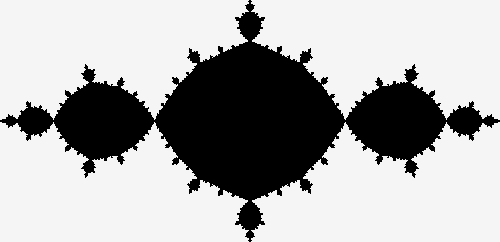

In [26]:
plotSkia 500 (complex -1 0) initialConditions

In [30]:
// f(z) = z^2
juliaSet (complex 0 0)
|> Chart.Point
|> Chart.withMarkerStyle(Size = 1)
|> Chart.withXAxisStyle(MinMax = (-2, 2))
|> Chart.withYAxisStyle(MinMax = (-2, 2))
|> Chart.withConfig staticConfig
|> Chart.toSVGString()
|> (fun chart -> chart.DisplayAs "text/html")

<path class="point" transform="translate(126.5,246.75)" d="M0.5,0A0.5,0.5 0 1,1 0,-0.5A0.5,0.5 0 0,1 0.5,0Z" style="opacity: 1; stroke-width: 0px; fill: rgb(99, 110, 250); fill-opa

In [31]:
// f(z) = z^2 - 1
juliaSet (complex -1 0)
|> Chart.Point
|> Chart.withMarkerStyle(Size = 1)
|> Chart.withXAxisStyle(MinMax = (-2, 2))
|> Chart.withYAxisStyle(MinMax = (-2, 2))
|> Chart.withConfig staticConfig
|> Chart.toSVGString()
|> (fun chart -> chart.DisplayAs "text/html")

<path class="point" transform="translate(104.5,192.15)" d="M0.


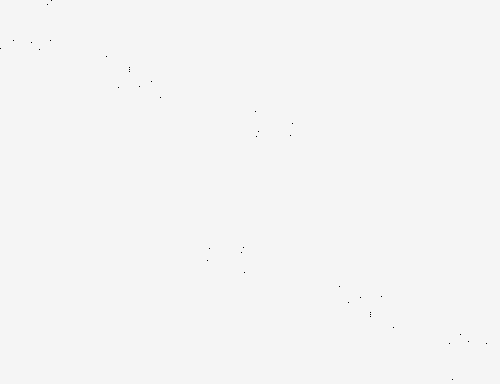

In [27]:
plotSkia 500 (complex 0.0 0.84) initialConditions

In [28]:
// f(z) = z^2 + 0.84i
juliaSet (complex 0 0.84)
|> plotJuliaSet

−1 −0.5 0 0.5 1 −1 −0.5 0 0.5 1


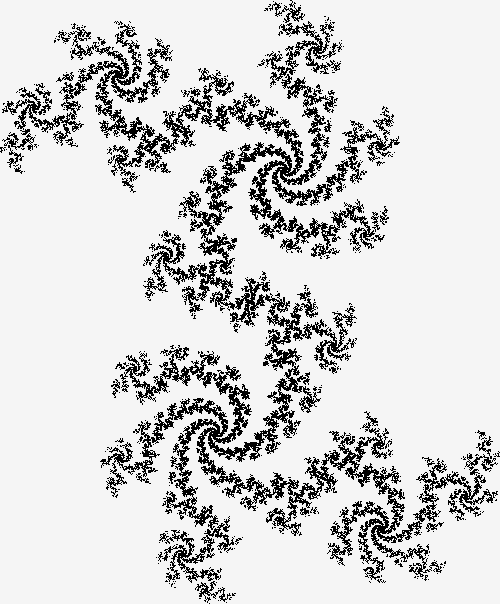

In [40]:
plotSkia 500 (complex 0.37 0.37) initialConditions

In [29]:
// f(z) = z^2 + 0.37 + 0.37i
juliaSet (complex 0.37 0.37)
|> plotJuliaSet

<path class="point" transform="translate(47.14,115.24)" d="M0.5,0A0.5,0.5 0 1,1 0,-0.5A0.5,0.5 0 0,1 0.5,0Z" style="opacity: 1; stroke-width: 0px; fill: rgb(99, 110, 250); fill-opacity:


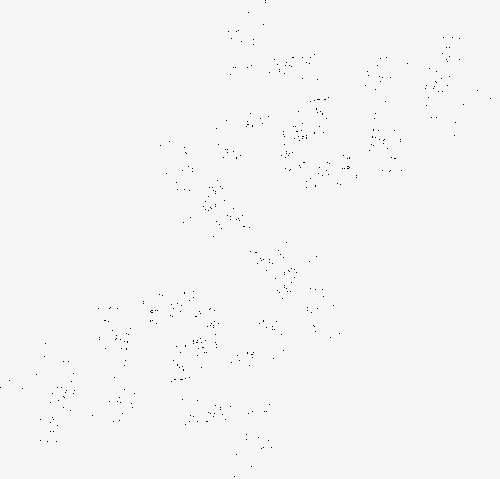

In [28]:
plotSkia 500 (complex 0 -0.72) initialConditions


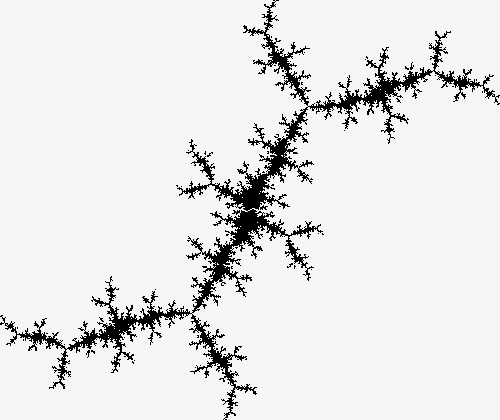

In [26]:
plotSkia 500 (complex -0.1 -0.88) initialConditions


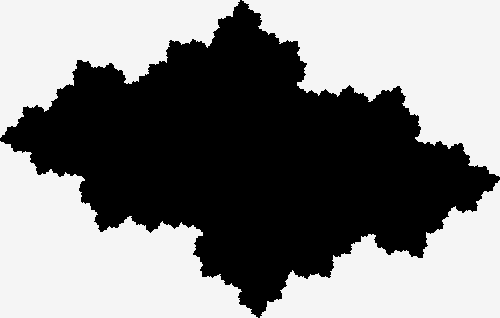

In [42]:
plotSkia 500 (complex -0.6 0.2) initialConditions


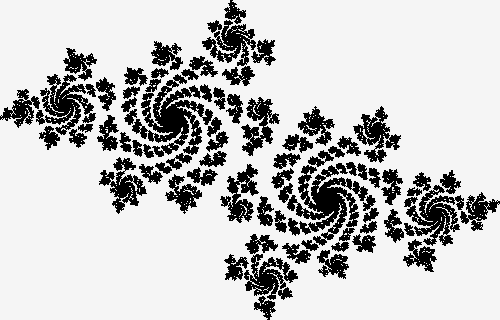

In [43]:
plotSkia 500 (complex -0.6 0.45) initialConditions


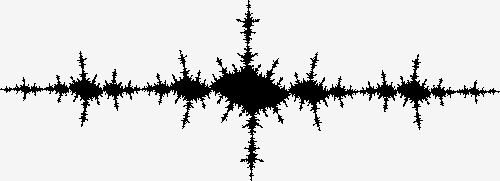

In [44]:
plotSkia 500 (complex -1.35 0.02) initialConditions


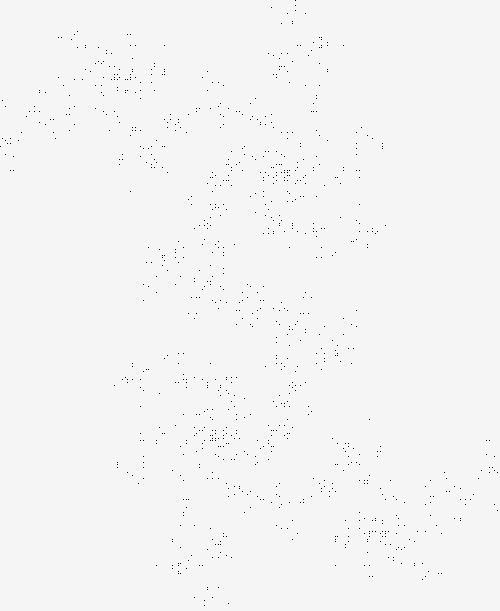

In [34]:
plotSkia 500 (complex 0.37 0.37) initialConditions


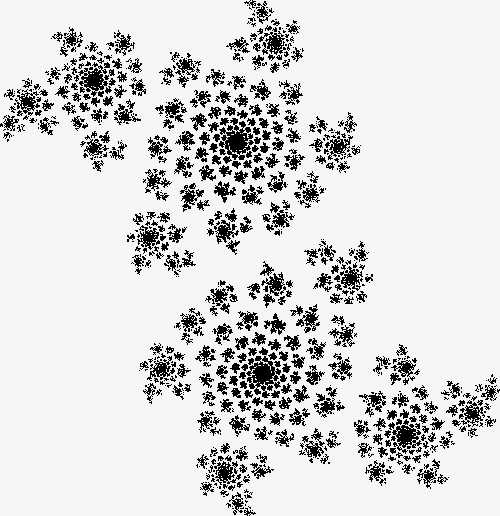

In [45]:
plotSkia 500 (complex 0.2 0.57) initialConditions


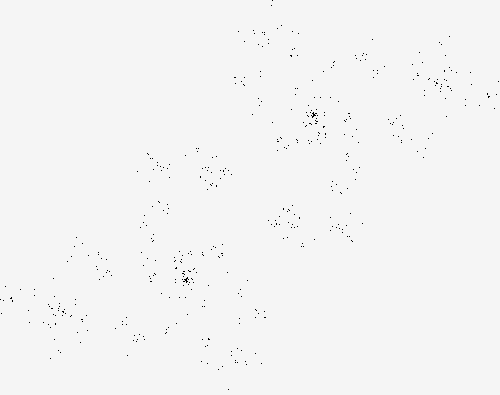

In [47]:
plotSkia 500 (complex -0.25 -0.7) initialConditions

### Euler's method

1. Choose an initial condition $f(0)$ and a step size $\Delta t$. Set $t = 0$.
2. Evaluate the rate of change of the function by plugging in to the right-hand side of the differential equation, $$ \frac{df}{dt} = F \left( f(t) \right).$$ Call this the rate of change $f(t)/dt$.

3. Use this rate of change to figure out the next value for the function: $$ f(t + \Delta t) = f(t) + \left( \frac{df(t)}{dt} \times \Delta t \right) . $$
4. Increase $t$ by $\Delta t$.
5. Go to step 2.

In [ ]:
type Equation3D = float -> float -> float -> float

type System =
    { DxDt: Equation3D
      DyDt: Equation3D
      DzDt: Equation3D
      InitialCondition: Coordinate }

let eulersMethod3D system stepSize stop =
    let {System.DxDt = dxdt; DyDt = dydt; DzDt = dzdt} = system
    let {System.InitialCondition = {X = x0; Y = y0; Z = z0}} = system
    let mutable x, y, z = x0, y0, z0
    {Time = 0; Coordinate = {X = x0; Y = y0; Z = z0}} ::
    [ for t in stepSize .. stepSize .. stop ->
        x <- x + (dxdt x y z) * stepSize
        y <- y + (dydt x y z) * stepSize
        z <- z + (dzdt x y z) * stepSize
        {Time = t; Coordinate = {X = x; Y = y; Z = z}} ]

### 3D plotting function

### Lorenz attractor

$$
\begin{align*}
\frac{dx}{dt} &= \sigma(y-x) \\
\frac{dy}{dt} &= x(\rho - z) - y \\
\frac{dz}{dt} &= xy - \beta z
\end{align*}
$$

let $\sigma = 10$, $\rho = 28$, and $\beta = 2.667$, and choose the initial conditions of $x(0) = 10$, $y(0) = 10$, and $z(0) = 10$ with a step size of $\Delta t = 0.0001$.

In [ ]:
let sigma = 10.0
let rho = 28.0
let beta = 2.667

let x0 = 50.0
let y0 = 50.0
let z0 = 50.0

let dxdt x y _z : float = sigma * (y - x)
let dydt x y  z : float = x * (rho - z) - y
let dzdt x y  z : float = x * y - beta * z

let lorenzSystem =
    { DxDt = fun x y _z -> sigma * (y - x)
      DyDt = fun x y  z -> x * (rho - z) - y
      DzDt = fun x y  z -> x * y - beta * z
      InitialCondition = {X = x0; Y = y0; Z = z0}}

let lorenz =
    eulersMethod3D lorenzSystem 0.001 30.0

let lorenzHighIterations =
    eulersMethod3D lorenzSystem 0.001 400.0

In [ ]:
let lorenzXAxis2D = LinearAxis.init(
    Title = Title.init "t",
    Color = Color.fromKeyword Black,
    ShowLine = true,
    LineColor = Color.fromKeyword Black,
    LineWidth = 2,
    Mirror = StyleParam.Mirror.True,
    Ticks = StyleParam.TickOptions.Inside,
    TickMode = StyleParam.TickMode.Linear,
    TickWidth = 2,
    Tick0 = 0,
    DTick = 15
)

let lorenzYAxis2D title (min, max) = LinearAxis.init(
    Title = Title.init title,
    Range = StyleParam.Range.ofMinMax (min, max),
    Color = Color.fromKeyword Black,
    ZeroLine = true,
    ZeroLineColor = Color.fromKeyword Black,
    ZeroLineWidth = 1,
    ShowLine = true,
    LineColor = Color.fromKeyword Black,
    LineWidth = 2,
    Mirror = StyleParam.Mirror.True,
    Ticks = StyleParam.TickOptions.Inside,
    TickMode = StyleParam.TickMode.Linear,
    TickWidth = 2,
    DTick = 5
)

let lorenzLayout = Layout.init(
    Width = 400,
    Height = 200,
    Margin = Margin.init(20, 20, 20, 20),
    PlotBGColor = Color.fromKeyword(White),
    PaperBGColor = Color.fromKeyword(White)
)

let lorenzMarker = Marker.init(
    Color = Color.fromKeyword(Black)
)

let plotLorenzAxis yAxisName (min, max) data =
    data
    |> Chart.Line
    |> Chart.withMarker lorenzMarker
    |> Chart.withLayout lorenzLayout
    |> Chart.withXAxis lorenzXAxis2D
    |> Chart.withYAxis (lorenzYAxis2D yAxisName (min, max))

In [ ]:
[
    lorenz
    |> List.filter (fun {Time = t} -> 10.0 <= t)
    |> List.map(fun plot -> (plot.Time, plot.Coordinate.X))
    |> plotLorenzAxis "x(t)" (-20, 20)

    lorenz
    |> List.filter (fun {Time = t} -> 10.0 <= t)
    |> List.map(fun plot -> (plot.Time, plot.Coordinate.Y))
    |> plotLorenzAxis "y(t)" (-30, 30)

    lorenz
    |> List.filter (fun {Time = t} -> 10.0 <= t)
    |> List.map(fun plot -> (plot.Time, plot.Coordinate.Z))
    |> plotLorenzAxis "z(t)" (0, 50)
]
|> Chart.Grid(3, 1)
|> Chart.withLayoutStyle(ShowLegend = false, Width = 400, Height = 600)
|> Chart.Display

In [ ]:
// Note:
//  - Remove the last line if you would like to view the 3D plot interactively in the notebook.
//  - Replace the last line with Chart.show if you would like to view the 3D plot interative in the browser.

lorenzHighIterations
|> List.filter (fun {Time = t} -> t >= 10)
|> plot
|> (fun chart -> Chart.Display3D(1.5, -1.5, 0.1, chart))

In [ ]:
let xRange = [-20.0 .. 2.0 .. 20.0]
let yRange = [-20.0 .. 2.0 .. 20.0]
let zRange = [  0.0 .. 2.5 .. 50.0]

let lorenzInitialConditionCube =
    [for x in xRange do
        for y in yRange do
            for z in zRange ->
                {X = x; Y = y; Z = z}]

In [ ]:
let attractorPointMarker = Marker.init(
    Size = 1,
    Color = Color.fromARGB 15 0 0 0
)

let around time value =
    let epsilon = 0.000001
    abs (value - time) <= epsilon

let solutions =
    lorenzInitialConditionCube
    |> List.map (fun point -> eulersMethod3D {lorenzSystem with InitialCondition = point} 0.01 21.0)

let solutionsAt time =
    solutions
    |> List.map (List.filter (fun {Time = t} -> around time t))
    |> List.concat
    |> List.map (fun {Coordinate = c} -> c.AsTuple)

[
    solutionsAt 0.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 0.1
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 0.2
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 1.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 5.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 20.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker
]
|> Chart.Grid(3, 2)
|> Chart.withSize(800, 800)


// [
//     lorenzInitialConditionCube
//     |> List.map Coordinate.ToTuple
//     |> Chart.Point3D
//     |> Chart.withMarker attractorPointMarker

//     lorenzInitialConditionCube
//     |> List.map Coordinate.ToTuple
//     |> List.map (eulersMethod3D dxdt dydt dzdt x0 y0 z0 0.01 )

### The Rössler Attractor

$$
\begin{align*}
\frac{dx}{dt} &= - y - z \\
\frac{dy}{dt} &= x + a y \\
\frac{dz}{dt} &= b + z(x-c) 
\end{align*}
$$

Let $ a = 0.1$, $b = 0.1$, and $c = 14$, and choose the initial conditions of $x(0) = 10$, $y(0) = 10$, and $z(0) = 10$ with a step size of $\Delta t = 0.0001$.

In [ ]:
let a = 0.1
let b = 0.1
let c = 14.0
let x0, y0, z0 = 10, 10, 10
let deltaT = 0.001

let dxdt _x  y  z: float = - y - z
let dydt  x  y _z: float = x + a * y
let dzdt  x _y  z: float = b + z * (x - c)

let rosslerSystem =
    { DxDt = fun x y z -> - y - z
      DyDt = fun x  y _z -> x + a * y
      DzDt = fun x y z -> b + z * (x - c)
      InitialCondition = {X = x0; Y = y0; Z = z0}
}

let rossler = eulersMethod3D rosslerSystem deltaT 70.0

let rosslerHighIterations = eulersMethod3D rosslerSystem deltaT 1000.0

In [ ]:
let attractorPointMarker = Marker.init(
    Size = 1,
    Color = Color.fromARGB 15 0 0 0
)

let around time value =
    let epsilon = 0.000001
    abs (value - time) <= epsilon

let solutions =
    lorenzInitialConditionCube
    |> List.map (fun point -> eulersMethod3D {rosslerSystem with InitialCondition = point} 0.1 21.0)

let solutionsAt time =
    solutions
    |> List.map (List.filter (fun {Time = t} -> around time t))
    |> List.concat
    |> List.map (fun {Coordinate = c} -> c.AsTuple)

[
    solutionsAt 0.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 0.1
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 0.2
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 1.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 5.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker

    solutionsAt 20.0
    |> Chart.Point3D
    |> Chart.withMarker attractorPointMarker
]
|> Chart.Grid(3, 3)
|> Chart.withSize(800, 800)

In [ ]:
let rosslerXAxis2D = LinearAxis.init(
    Title = Title.init "t",
    Color = Color.fromKeyword Black,
    ShowLine = true,
    LineColor = Color.fromKeyword Black,
    LineWidth = 2,
    Mirror = StyleParam.Mirror.True,
    Ticks = StyleParam.TickOptions.Inside,
    TickMode = StyleParam.TickMode.Linear,
    TickWidth = 2,
    Tick0 = 0,
    DTick = 10
)

let rosslerYAxis2D title (min, max) = LinearAxis.init(
    Title = Title.init title,
    Range = StyleParam.Range.ofMinMax (min, max),
    Color = Color.fromKeyword Black,
    ZeroLine = true,
    ZeroLineColor = Color.fromKeyword Black,
    ZeroLineWidth = 1,
    ShowLine = true,
    LineColor = Color.fromKeyword Black,
    LineWidth = 2,
    Mirror = StyleParam.Mirror.True,
    Ticks = StyleParam.TickOptions.Inside,
    TickMode = StyleParam.TickMode.Linear,
    TickWidth = 2,
    DTick = 10
)

let rosslerLayout = Layout.init(
    Width = 400,
    Height = 200,
    Margin = Margin.init(20, 20, 20, 20),
    PlotBGColor = Color.fromKeyword(White),
    PaperBGColor = Color.fromKeyword(White)
)

let rosslerMarker = Marker.init(
    Color = Color.fromKeyword(Black)
)

let plotRosslerAxis yAxisName (min, max) data =
    data
    |> Chart.Line
    |> Chart.withMarker rosslerMarker
    |> Chart.withLayout rosslerLayout
    |> Chart.withXAxis rosslerXAxis2D
    |> Chart.withYAxis (rosslerYAxis2D yAxisName (min, max))

In [ ]:
[
    rossler
    |> List.map (fun plot -> (plot.Time, plot.Coordinate.X))
    |> plotRosslerAxis "x(t)" (-20, 30);

    rossler
    |> List.map (fun plot -> (plot.Time, plot.Coordinate.Y))
    |> plotRosslerAxis "y(t)" (-30, 20);

    rossler
    |> List.map (fun plot -> (plot.Time, plot.Coordinate.Z))
    |> plotRosslerAxis "z(t)" (0, 40);
]
|> Chart.Grid(3, 1)
|> Chart.withLayoutStyle(ShowLegend = false, Width = 400, Height = 600)
|> Chart.Display

In [ ]:
rossler
|> List.map (fun plot -> plot.Coordinate.AsTuple)
|> Chart.Line3D

In [ ]:
// Note:
//  - Remove the last line if you would like to view the 3D plot interactively in the notebook.
//  - Replace the last line with Chart.show if you would like to view the 3D plot interative in the browser.

rosslerHighIterations
|> plot
|> (fun chart -> Chart.Display3D(-1.7, -0.5, 0.3, chart))